# Model Maker

In [1]:
import turicreate as tc
from copy import deepcopy
from math import floor

## Import Data

In [2]:
images = tc.load_images("./Cards")

In [3]:
pathes = images['path']

In [4]:
annotations = tc.SFrame("./out.csv")

Finished parsing file /Users/ryangaines/Google Drive/Fall 2018/CS 499/PokerHandRecognizer/out.csv

Parsing completed. Parsed 100 lines in 0.12129 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,int,int,int,int]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /Users/ryangaines/Google Drive/Fall 2018/CS 499/PokerHandRecognizer/out.csv

Parsing completed. Parsed 1040 lines in 0.009939 secs.

In [5]:
annotations

path,name,xMin,xMax,yMin,yMax
./Cards/IMG_2634.jpeg,Card,1167,1860,1532,2466
./Cards/IMG_2634.jpeg,Diamond,1194,1254,1696,1773
./Cards/IMG_2634.jpeg,Diamond,1766,1840,2235,2319
./Cards/IMG_2634.jpeg,Ace,1184,1268,1573,1686
./Cards/IMG_2634.jpeg,Ace,1756,1847,2326,2439
./Cards/IMG_2663.jpeg,Card,1078,2036,1658,2331
./Cards/IMG_2663.jpeg,Three,1111,1231,2228,2309
./Cards/IMG_2663.jpeg,Diamond,1234,1315,2245,2305
./Cards/IMG_2663.jpeg,Diamond,1796,1877,1676,1740
./Cards/IMG_2663.jpeg,Three,1877,1994,1666,1753


In [6]:
finalList = {}
finalPath = []
finalDict = []
currPathDict = []
currPath = annotations['path'][0]
for i in annotations:
    if i['path'] == currPath:
        instance = {'coordinates': {'height': i['yMax'] - i['yMin'], 'width': i['xMax'] - i['xMin'], 'x': floor((i['xMax'] + i['xMin'])/2), 'y': floor((i['yMax'] + i['yMin'])/2)},'label': i['name']}
        currPathDict.append(instance)
    else:               
        finalPath.append(currPath)
        finalDict.append(deepcopy(currPathDict))
        finalList[currPath] = deepcopy(currPathDict)
        currPath = i['path']
        currPathDict =[]
        instance = {'coordinates': {'height': i['yMax'] - i['yMin'], 'width': i['xMax'] - i['xMin'], 'x': floor((i['xMax'] + i['xMin'])/2), 'y': floor((i['yMax'] + i['yMin'])/2)},'label': i['name']}
        currPathDict.append(instance)
finalList[currPath] = deepcopy(currPathDict)
finalPath.append(currPath)
finalDict.append(deepcopy(currPathDict))


In [7]:
finalDict2 = []
for i in finalDict:
    currDict2 = []
    cardIndex = 0
    suitType = ""
    suitIndex = []
    for j in range(len(i)):
        if i[j]['label'] == "Card":
            cardIndex = j
        if i[j]['label'] in ["Diamond", "Club", "Spade", "Heart"]:
            suitType = i[j]['label']
            suitIndex.append(j)
    i[cardIndex]['label'] = suitType
    for k in range(len(i)):
        if k not in suitIndex:
            currDict2.append(i[k]) 
    
    finalDict2.append(currDict2)
finalDict = finalDict2

In [8]:
finalDict[0]

[{'coordinates': {'height': 934, 'width': 693, 'x': 1513, 'y': 1999},
  'label': 'Diamond'},
 {'coordinates': {'height': 113, 'width': 84, 'x': 1226, 'y': 1629},
  'label': 'Ace'},
 {'coordinates': {'height': 113, 'width': 91, 'x': 1801, 'y': 2382},
  'label': 'Ace'}]

In [9]:
sa = tc.SArray(data=finalPath)

In [10]:
sa2 = tc.SArray(data=finalDict)

In [11]:
len(sa2)

208

In [12]:
sf = tc.SFrame({'path':sa,'annotations':sa2})

In [13]:
sf

annotations,path
"[{'coordinates':{'height': 934, 'width': ...",./Cards/IMG_2634.jpeg
"[{'coordinates':{'height': 673, 'width': ...",./Cards/IMG_2663.jpeg
"[{'coordinates':{'height': 669, 'width': ...",./Cards/IMG_2675.jpeg
"[{'coordinates':{'height': 974, 'width': ...",./Cards/IMG_2622.jpeg
"[{'coordinates':{'height': 659, 'width': ...",./Cards/IMG_2659.jpeg
"[{'coordinates':{'height': 943, 'width': ...",./Cards/IMG_2570.jpeg
"[{'coordinates':{'height': 953, 'width': ...",./Cards/IMG_2618.jpeg
"[{'coordinates':{'height': 981, 'width': ...",./Cards/IMG_2531.jpeg
"[{'coordinates':{'height': 930, 'width': ...",./Cards/IMG_2589.jpeg
"[{'coordinates':{'height': 937, 'width': ...",./Cards/IMG_2566.jpeg


In [14]:
data = images.join(sf)

In [29]:
data

path,image,annotations
./Cards/IMG_2634.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 934, 'width': ..."
./Cards/IMG_2663.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 673, 'width': ..."
./Cards/IMG_2675.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 669, 'width': ..."
./Cards/IMG_2622.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 974, 'width': ..."
./Cards/IMG_2659.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 659, 'width': ..."
./Cards/IMG_2570.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 943, 'width': ..."
./Cards/IMG_2618.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 953, 'width': ..."
./Cards/IMG_2531.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 981, 'width': ..."
./Cards/IMG_2589.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 930, 'width': ..."
./Cards/IMG_2566.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 937, 'width': ..."


In [30]:
train_data, test_data = data.random_split(0.8)

In [31]:
test_data['bounding'] = tc.object_detector.util.draw_bounding_boxes(test_data['image'], test_data['annotations'])

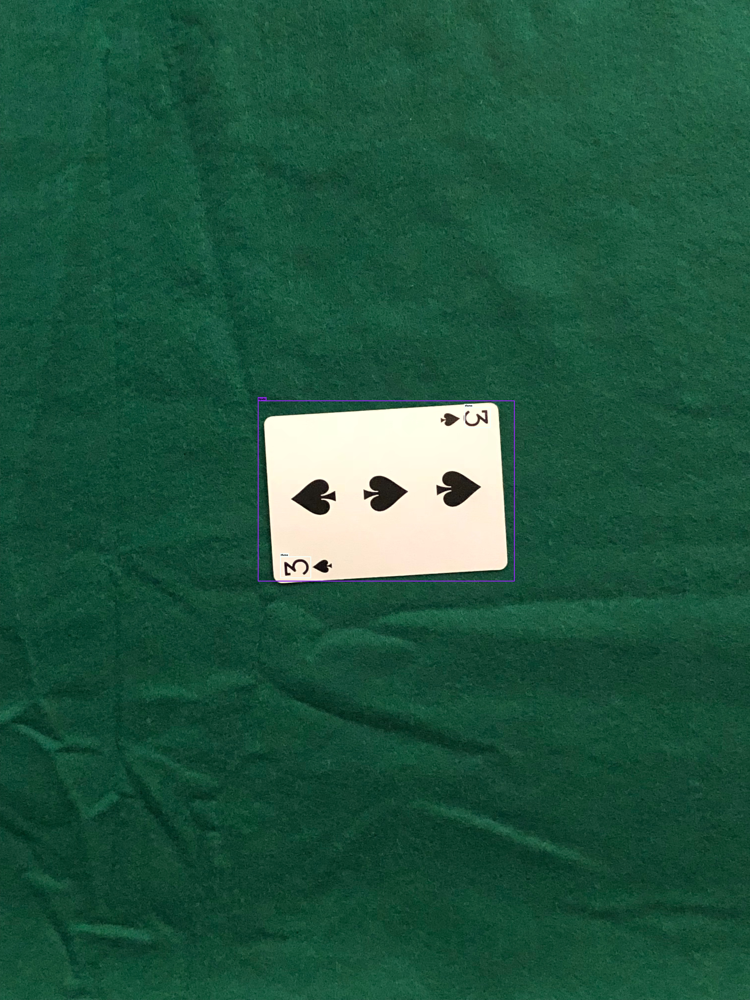

In [33]:
test_data['bounding'][9].show()

In [36]:
model = tc.object_detector.create(train_data)

Using 'image' as feature column
Using 'annotations' as annotations column
Setting 'batch_size' to 32
Using CPU to create model
Setting 'max_iterations' to 3000
+--------------+--------------+--------------+
| Iteration    | Loss         | Elapsed Time |
+--------------+--------------+--------------+
| 1            | 13.293       | 29.7         |
| 2            | 13.287       | 61.4         |
| 3            | 13.304       | 90.5         |
| 4            | 13.268       | 118.4        |
| 5            | 13.186       | 146.7        |
| 6            | 13.052       | 178.3        |
| 7            | 12.902       | 209.0        |
| 8            | 12.733       | 254.6        |
| 9            | 12.518       | 294.8        |
| 10           | 12.264       | 326.7        |
| 11           | 11.981       | 360.1        |
| 12           | 11.728       | 389.0        |
| 13           | 11.474       | 420.8        |
| 14           | 11.263       | 450.9        |
| 15           | 11.076       | 479.3    

| 169          | 2.688        | 4808.3       |
| 170          | 2.703        | 4835.4       |
| 171          | 2.721        | 4866.1       |
| 172          | 2.712        | 4893.7       |
| 173          | 2.704        | 4920.7       |
| 174          | 2.713        | 4948.2       |
| 175          | 2.684        | 4975.1       |
| 176          | 2.660        | 5006.1       |
| 177          | 2.651        | 5033.3       |
| 178          | 2.634        | 5065.2       |
| 179          | 2.615        | 5092.5       |
| 180          | 2.605        | 5119.9       |
| 181          | 2.573        | 5151.2       |
| 182          | 2.573        | 5179.1       |
| 183          | 2.590        | 5208.7       |
| 184          | 2.553        | 5236.1       |
| 185          | 2.566        | 5263.3       |
| 186          | 2.541        | 5294.6       |
| 187          | 2.526        | 5321.8       |
| 188          | 2.511        | 5349.4       |
| 189          | 2.503        | 5376.7       |
| 190        

| 344          | 1.867        | 9715.0       |
| 345          | 1.884        | 9742.6       |
| 346          | 1.880        | 9773.2       |
| 347          | 1.871        | 9801.2       |
| 348          | 1.875        | 9828.6       |
| 349          | 1.876        | 9856.3       |
| 350          | 1.874        | 9883.4       |
| 351          | 1.877        | 9914.5       |
| 352          | 1.874        | 9941.6       |
| 353          | 1.871        | 9968.7       |
| 354          | 1.853        | 9995.7       |
| 355          | 1.860        | 10022.5      |
| 356          | 1.841        | 10054.4      |
| 357          | 1.823        | 10080.9      |
| 358          | 1.824        | 10107.7      |
| 359          | 1.811        | 10134.7      |
| 360          | 1.821        | 10162.8      |
| 361          | 1.812        | 10193.5      |
| 362          | 1.777        | 10220.9      |
| 363          | 1.767        | 10247.8      |
| 364          | 1.790        | 10275.1      |
| 365        

| 519          | 1.602        | 14609.6      |
| 520          | 1.605        | 14636.6      |
| 521          | 1.584        | 14667.9      |
| 522          | 1.587        | 14695.3      |
| 523          | 1.585        | 14722.5      |
| 524          | 1.582        | 14749.8      |
| 525          | 1.591        | 14776.4      |
| 526          | 1.571        | 14807.4      |
| 527          | 1.576        | 14835.1      |
| 528          | 1.560        | 14862.0      |
| 529          | 1.553        | 14888.8      |
| 530          | 1.545        | 14916.0      |
| 531          | 1.532        | 14946.8      |
| 532          | 1.531        | 14974.5      |
| 533          | 1.536        | 15001.6      |
| 534          | 1.530        | 15028.4      |
| 535          | 1.521        | 15056.3      |
| 536          | 1.500        | 15087.2      |
| 537          | 1.494        | 15114.5      |
| 538          | 1.506        | 15141.6      |
| 539          | 1.518        | 15168.8      |
| 540        

| 694          | 1.436        | 19524.3      |
| 695          | 1.433        | 19552.4      |
| 696          | 1.429        | 19583.7      |
| 697          | 1.439        | 19613.6      |
| 698          | 1.442        | 19641.6      |
| 699          | 1.440        | 19669.1      |
| 700          | 1.428        | 19697.0      |
| 701          | 1.433        | 19728.6      |
| 702          | 1.439        | 19755.8      |
| 703          | 1.430        | 19783.3      |
| 704          | 1.443        | 19810.7      |
| 705          | 1.451        | 19839.2      |
| 706          | 1.438        | 19870.1      |
| 707          | 1.426        | 19897.4      |
| 708          | 1.411        | 19924.3      |
| 709          | 1.400        | 19951.8      |
| 710          | 1.389        | 19979.5      |
| 711          | 1.385        | 20010.9      |
| 712          | 1.370        | 20038.6      |
| 713          | 1.370        | 20066.0      |
| 714          | 1.368        | 20093.1      |
| 715        

| 869          | 1.390        | 24452.0      |
| 870          | 1.381        | 24479.1      |
| 871          | 1.388        | 24509.6      |
| 872          | 1.400        | 24537.6      |
| 873          | 1.395        | 24564.9      |
| 874          | 1.393        | 24592.0      |
| 875          | 1.386        | 24618.8      |
| 876          | 1.376        | 24649.8      |
| 877          | 1.369        | 24676.9      |
| 878          | 1.368        | 24703.9      |
| 879          | 1.375        | 24730.9      |
| 880          | 1.366        | 24758.3      |
| 881          | 1.377        | 24789.9      |
| 882          | 1.356        | 24816.9      |
| 883          | 1.353        | 24843.8      |
| 884          | 1.346        | 24870.6      |
| 885          | 1.366        | 24898.1      |
| 886          | 1.356        | 24929.5      |
| 887          | 1.347        | 24957.8      |
| 888          | 1.342        | 24984.5      |
| 889          | 1.343        | 25012.2      |
| 890        

| 1044         | 1.281        | 29384.3      |
| 1045         | 1.275        | 29411.0      |
| 1046         | 1.273        | 29441.8      |
| 1047         | 1.265        | 29469.3      |
| 1048         | 1.266        | 29496.6      |
| 1049         | 1.266        | 29523.5      |
| 1050         | 1.260        | 29551.1      |
| 1051         | 1.253        | 29582.6      |
| 1052         | 1.261        | 29610.9      |
| 1053         | 1.262        | 29637.9      |
| 1054         | 1.258        | 29664.9      |
| 1055         | 1.260        | 29691.8      |
| 1056         | 1.256        | 29723.1      |
| 1057         | 1.257        | 29750.2      |
| 1058         | 1.258        | 29777.1      |
| 1059         | 1.255        | 29804.0      |
| 1060         | 1.255        | 29832.0      |
| 1061         | 1.248        | 29862.9      |
| 1062         | 1.253        | 29890.9      |
| 1063         | 1.251        | 29918.2      |
| 1064         | 1.257        | 29945.3      |
| 1065       

| 1219         | 1.258        | 34306.8      |
| 1220         | 1.251        | 34333.7      |
| 1221         | 1.250        | 34364.6      |
| 1222         | 1.257        | 34391.8      |
| 1223         | 1.250        | 34419.9      |
| 1224         | 1.250        | 34447.1      |
| 1225         | 1.251        | 34474.6      |
| 1226         | 1.239        | 34506.2      |
| 1227         | 1.224        | 34535.4      |
| 1228         | 1.222        | 34562.0      |
| 1229         | 1.223        | 34589.3      |
| 1230         | 1.220        | 34616.1      |
| 1231         | 1.219        | 34648.2      |
| 1232         | 1.217        | 34675.5      |
| 1233         | 1.205        | 34702.8      |
| 1234         | 1.212        | 34730.0      |
| 1235         | 1.220        | 34757.3      |
| 1236         | 1.214        | 34788.6      |
| 1237         | 1.210        | 34816.2      |
| 1238         | 1.214        | 34843.6      |
| 1239         | 1.208        | 34870.7      |
| 1240       

| 1394         | 1.169        | 39267.3      |
| 1395         | 1.173        | 39303.1      |
| 1396         | 1.169        | 39349.8      |
| 1397         | 1.170        | 39395.7      |
| 1398         | 1.171        | 39424.7      |
| 1399         | 1.168        | 39453.9      |
| 1400         | 1.172        | 39489.1      |
| 1401         | 1.168        | 39523.3      |
| 1402         | 1.176        | 39551.1      |
| 1403         | 1.178        | 39580.0      |
| 1404         | 1.178        | 39608.4      |
| 1405         | 1.169        | 39637.0      |
| 1406         | 1.163        | 39670.2      |
| 1407         | 1.164        | 39700.0      |
| 1408         | 1.172        | 39728.2      |
| 1409         | 1.177        | 39755.4      |
| 1410         | 1.179        | 39782.9      |
| 1411         | 1.188        | 39814.3      |
| 1412         | 1.189        | 39841.7      |
| 1413         | 1.190        | 39868.6      |
| 1414         | 1.181        | 39895.7      |
| 1415       

| 1569         | 1.070        | 44898.4      |
| 1570         | 1.068        | 44928.0      |
| 1571         | 1.053        | 44962.1      |
| 1572         | 1.067        | 44991.3      |
| 1573         | 1.079        | 45020.3      |
| 1574         | 1.079        | 45053.9      |
| 1575         | 1.073        | 45084.6      |
| 1576         | 1.065        | 45117.4      |
| 1577         | 1.058        | 45147.8      |
| 1578         | 1.065        | 45177.1      |
| 1579         | 1.064        | 45206.3      |
| 1580         | 1.058        | 45236.2      |
| 1581         | 1.065        | 45269.6      |
| 1582         | 1.072        | 45298.5      |
| 1583         | 1.068        | 45331.6      |
| 1584         | 1.062        | 45360.8      |
| 1585         | 1.057        | 45390.8      |
| 1586         | 1.055        | 45433.5      |
| 1587         | 1.049        | 45462.9      |
| 1588         | 1.047        | 45491.7      |
| 1589         | 1.054        | 45520.1      |
| 1590       

| 1744         | 0.998        | 50339.5      |
| 1745         | 1.003        | 50366.4      |
| 1746         | 1.008        | 50396.9      |
| 1747         | 1.020        | 50424.4      |
| 1748         | 1.013        | 50451.0      |
| 1749         | 1.001        | 50477.7      |
| 1750         | 0.994        | 50505.4      |
| 1751         | 0.994        | 50536.6      |
| 1752         | 0.992        | 50564.3      |
| 1753         | 0.983        | 50591.3      |
| 1754         | 0.989        | 50618.6      |
| 1755         | 0.983        | 50644.9      |
| 1756         | 0.978        | 50675.9      |
| 1757         | 0.978        | 50702.2      |
| 1758         | 0.979        | 50729.2      |
| 1759         | 0.987        | 50756.0      |
| 1760         | 0.980        | 50783.0      |
| 1761         | 0.977        | 50813.4      |
| 1762         | 0.984        | 50840.4      |
| 1763         | 0.979        | 50867.3      |
| 1764         | 0.985        | 50893.9      |
| 1765       

| 1919         | 0.972        | 56498.1      |
| 1920         | 0.971        | 56525.5      |
| 1921         | 0.968        | 56556.1      |
| 1922         | 0.976        | 56582.8      |
| 1923         | 0.979        | 56611.3      |
| 1924         | 0.976        | 56638.6      |
| 1925         | 0.979        | 56666.2      |
| 1926         | 0.977        | 56697.1      |
| 1927         | 0.981        | 56724.5      |
| 1928         | 0.993        | 56751.8      |
| 1929         | 0.987        | 56778.7      |
| 1930         | 0.988        | 56808.8      |
| 1931         | 0.987        | 56840.0      |
| 1932         | 0.987        | 56867.9      |
| 1933         | 0.990        | 56895.9      |
| 1934         | 0.991        | 56923.3      |
| 1935         | 0.993        | 56951.2      |
| 1936         | 0.985        | 56982.4      |
| 1937         | 0.988        | 57009.9      |
| 1938         | 0.982        | 57037.1      |
| 1939         | 0.988        | 57064.2      |
| 1940       

| 2094         | 0.999        | 61418.9      |
| 2095         | 1.001        | 61445.7      |
| 2096         | 0.999        | 61477.0      |
| 2097         | 1.000        | 61504.3      |
| 2098         | 0.987        | 61532.5      |
| 2099         | 1.004        | 61559.5      |
| 2100         | 0.999        | 61586.3      |
| 2101         | 1.000        | 61617.1      |
| 2102         | 0.986        | 61646.2      |
| 2103         | 0.983        | 61673.3      |
| 2104         | 0.985        | 61700.2      |
| 2105         | 0.986        | 61727.5      |
| 2106         | 0.973        | 61758.5      |
| 2107         | 0.976        | 61785.7      |
| 2108         | 0.982        | 61812.5      |
| 2109         | 0.980        | 61840.3      |
| 2110         | 0.978        | 61868.8      |
| 2111         | 0.971        | 61899.5      |
| 2112         | 0.970        | 61926.7      |
| 2113         | 0.975        | 61953.5      |
| 2114         | 0.973        | 61980.5      |
| 2115       

| 2269         | 0.975        | 66327.3      |
| 2270         | 0.970        | 66354.0      |
| 2271         | 0.967        | 66384.9      |
| 2272         | 0.958        | 66412.7      |
| 2273         | 0.964        | 66439.9      |
| 2274         | 0.959        | 66467.0      |
| 2275         | 0.968        | 66493.5      |
| 2276         | 0.968        | 66524.6      |
| 2277         | 0.965        | 66552.3      |
| 2278         | 0.972        | 66579.1      |
| 2279         | 0.967        | 66606.0      |
| 2280         | 0.966        | 66633.2      |
| 2281         | 0.966        | 66664.7      |
| 2282         | 0.960        | 66692.5      |
| 2283         | 0.962        | 66719.4      |
| 2284         | 0.958        | 66746.6      |
| 2285         | 0.959        | 66773.9      |
| 2286         | 0.956        | 66805.1      |
| 2287         | 0.957        | 66832.0      |
| 2288         | 0.960        | 66859.0      |
| 2289         | 0.964        | 66886.2      |
| 2290       

| 2444         | 0.968        | 71434.4      |
| 2445         | 0.967        | 71515.1      |
| 2446         | 0.965        | 72886.5      |
| 2447         | 0.969        | 72918.2      |
| 2448         | 0.970        | 72950.1      |
| 2449         | 0.984        | 72993.7      |
| 2450         | 0.988        | 73028.4      |
| 2451         | 0.983        | 73067.1      |
| 2452         | 0.985        | 73101.1      |
| 2453         | 0.984        | 73134.8      |
| 2454         | 0.982        | 73168.1      |
| 2455         | 0.982        | 73200.2      |
| 2456         | 0.974        | 73236.9      |
| 2457         | 0.979        | 73270.6      |
| 2458         | 0.984        | 73304.4      |
| 2459         | 0.977        | 73337.1      |
| 2460         | 0.984        | 73369.7      |
| 2461         | 0.981        | 73406.7      |
| 2462         | 0.972        | 73439.2      |
| 2463         | 0.977        | 73471.4      |
| 2464         | 0.963        | 73500.8      |
| 2465       

| 2619         | 0.941        | 78143.1      |
| 2620         | 0.939        | 78171.5      |
| 2621         | 0.941        | 78203.5      |
| 2622         | 0.943        | 78233.0      |
| 2623         | 0.945        | 78261.4      |
| 2624         | 0.942        | 78288.4      |
| 2625         | 0.947        | 78316.2      |
| 2626         | 0.941        | 78352.8      |
| 2627         | 0.935        | 78383.4      |
| 2628         | 0.931        | 78412.7      |
| 2629         | 0.930        | 78441.8      |
| 2630         | 0.940        | 78471.5      |
| 2631         | 0.952        | 78505.4      |
| 2632         | 0.954        | 78536.1      |
| 2633         | 0.951        | 78566.7      |
| 2634         | 0.954        | 78597.6      |
| 2635         | 0.959        | 78638.0      |
| 2636         | 0.966        | 78674.8      |
| 2637         | 0.960        | 78706.0      |
| 2638         | 0.958        | 78738.6      |
| 2639         | 0.957        | 78769.5      |
| 2640       

| 2794         | 0.969        | 84860.3      |
| 2795         | 0.965        | 84895.4      |
| 2796         | 0.957        | 84929.5      |
| 2797         | 0.955        | 84959.7      |
| 2798         | 0.953        | 84991.0      |
| 2799         | 0.955        | 85021.5      |
| 2800         | 0.955        | 85049.9      |
| 2801         | 0.960        | 85086.7      |
| 2802         | 0.956        | 85118.9      |
| 2803         | 0.950        | 85152.2      |
| 2804         | 0.962        | 85183.7      |
| 2805         | 0.957        | 85216.1      |
| 2806         | 0.968        | 85251.5      |
| 2807         | 0.971        | 85283.7      |
| 2808         | 0.968        | 85312.1      |
| 2809         | 0.959        | 85340.5      |
| 2810         | 0.963        | 85368.1      |
| 2811         | 0.955        | 85401.0      |
| 2812         | 0.953        | 85431.4      |
| 2813         | 0.945        | 85465.6      |
| 2814         | 0.956        | 85495.6      |
| 2815       

| 2969         | 0.968        | 90297.3      |
| 2970         | 0.962        | 90325.8      |
| 2971         | 0.963        | 90364.3      |
| 2972         | 0.976        | 90395.5      |
| 2973         | 0.975        | 90423.8      |
| 2974         | 0.984        | 90452.1      |
| 2975         | 0.984        | 90496.3      |
| 2976         | 0.991        | 90537.9      |
| 2977         | 0.988        | 90567.3      |
| 2978         | 0.983        | 90596.6      |
| 2979         | 0.986        | 90626.4      |
| 2980         | 0.978        | 90659.9      |
| 2981         | 0.976        | 90699.3      |
| 2982         | 0.972        | 90729.4      |
| 2983         | 0.979        | 90758.4      |
| 2984         | 0.979        | 90787.1      |
| 2985         | 0.981        | 90815.8      |
| 2986         | 0.979        | 90847.9      |
| 2987         | 0.971        | 90876.8      |
| 2988         | 0.970        | 90904.7      |
| 2989         | 0.972        | 90932.3      |
| 2990       

In [37]:
model.save("test2.model")

In [38]:
predictions = model.predict(test_data)

Predicting  1/48
Predicting 33/48
Predicting 48/48


In [39]:
predictions[2]

[{'label': 'Heart',
  'type': 'rectangle',
  'coordinates': {'x': 1501.0189434146544,
   'y': 1941.9649847364685,
   'width': 661.0086813706616,
   'height': 983.1045262263372},
  'confidence': 0.9035911894792599},
 {'label': 'Eight',
  'type': 'rectangle',
  'coordinates': {'x': 1790.2505455280625,
   'y': 2316.3194349464857,
   'width': 76.20729622474119,
   'height': 106.80290354215231},
  'confidence': 0.6827706827516561},
 {'label': 'Eight',
  'type': 'rectangle',
  'coordinates': {'x': 1211.3048187847814,
   'y': 1569.2645015346252,
   'width': 78.88803027226368,
   'height': 109.31790513258693},
  'confidence': 0.6234851774710949}]

In [40]:
test_data['predicted'] = tc.object_detector.util.draw_bounding_boxes(test_data['image'], predictions)

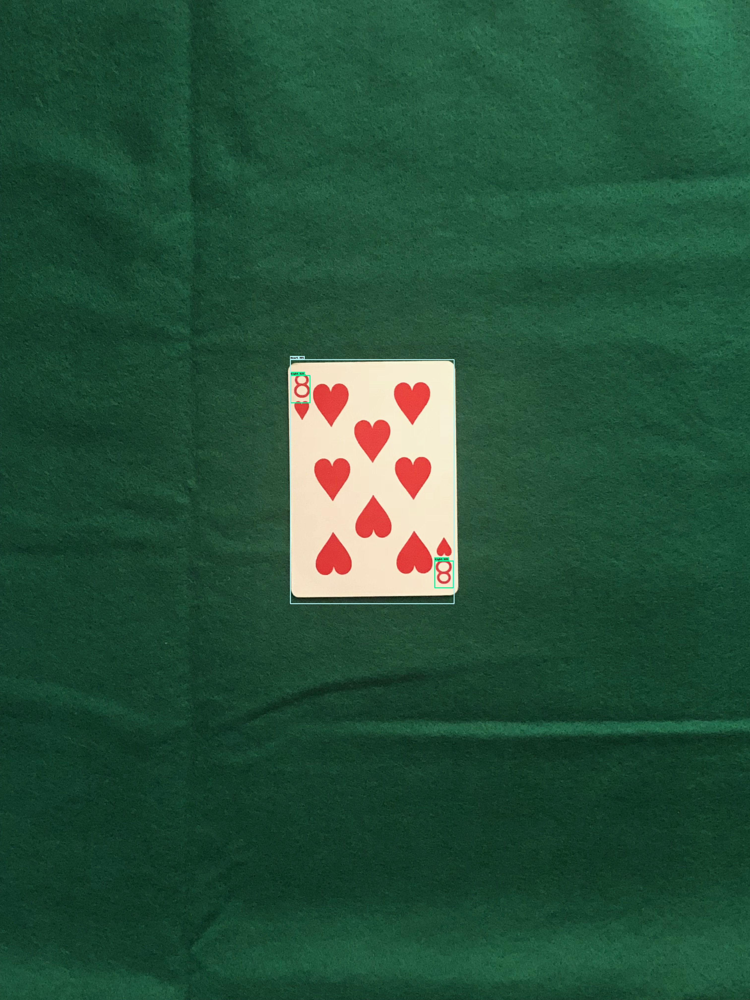

In [41]:
test_data['predicted'][2].show()

In [15]:
model = tc.load_model("test2.model")


In [ ]:
predictions = model.predict(data)

Predicting   1/208
Predicting  33/208
Predicting  65/208
Predicting  97/208
Predicting 129/208


In [ ]:
data['predicted'] = tc.object_detector.util.draw_bounding_boxes(data['image'], predictions)

In [ ]:
for i in range():
    data['predicted'][i].show()